In [1]:
from IPython.core.display import HTML

# COVID-19

In [28]:
HTML('''<div class="flourish-embed flourish-cards" data-src="visualisation/1810417" data-url="https://flo.uri.sh/visualisation/1810417/embed"><script src="https://public.flourish.studio/resources/embed.js"></script></div>''')

# Ships

In [29]:
HTML('''<div class="flourish-embed flourish-cards" data-src="visualisation/1816605" data-url="https://flo.uri.sh/visualisation/1816605/embed"><script src="https://public.flourish.studio/resources/embed.js"></script></div>''')

# Libraries

In [2]:
# Import
# ======
# essential libraries
import random
from datetime import timedelta

# storing and anaysis
import numpy as np
import pandas as pd

# visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import calmap
import folium
# color pallette
cnf, dth, rec, act = '#393e46', '#ff2e63', '#21bf73', '#fe9801' 

# converter
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()   

# hide warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
# for offline ploting
# ===================
from plotly.offline import plot, iplot, init_notebook_mode
init_notebook_mode(connected=True)

In [4]:
# list files
# ==========

# !ls ../input/corona-virus-report

In [5]:
# importing datasets
# ==================

full_table = pd.read_csv("C:\\Users\\suppy\\Desktop\\Python\\Covid 19\\covid_19_clean_complete.csv", 
                         parse_dates=['Date'])
full_table.sample(6)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
2372,Tibet,China,31.6927,88.0924,2020-01-29,0.0,0.0,0.0
6390,NaN,Taiwan*,23.7000,121.0000,2020-02-11,18.0,0.0,1.0
18618,NaN,Spain,40.0000,-4.0000,2020-03-22,28768.0,1772.0,2575.0
18791,NaN,Vietnam,16.0000,108.0000,2020-03-22,113.0,0.0,17.0
4568,NaN,Seychelles,-4.6796,55.4920,2020-02-05,0.0,0.0,0.0
5176,Saskatchewan,Canada,52.9399,-106.4509,2020-02-07,0.0,0.0,0.0


In [6]:
# dataframe info
# full_table.info()

In [7]:
# checking for missing value
# full_table.isna().sum()

# Preprocessing

In [8]:
#ship
#====
# ship rows
ship_rows = full_table['Province/State'].str.contains('Grand Princess') | full_table['Province/State'].str.contains('Diamond Princess') | full_table['Country/Region'].str.contains('Diamond Princess') | full_table['Country/Region'].str.contains('MS Zaandam')

# ship
ship = full_table[ship_rows]

# full table 
full_table = full_table[~(ship_rows)]

# Latest cases from the ships
ship_latest = ship[ship['Date']==max(ship['Date'])]

# ship_latest.style.background_gradient(cmap='Pastel1_r')

In [9]:
# Cleaning data
# =============

# Active Case = confirmed - deaths - recovered
full_table['Active'] = full_table['Confirmed'] - full_table['Deaths'] - full_table['Recovered']

# replacing Mainland china with just China
full_table['Country/Region'] = full_table['Country/Region'].replace('Mainland China', 'China')

# filling missing values 
full_table[['Province/State']] = full_table[['Province/State']].fillna('')
full_table[['Confirmed', 'Deaths', 'Recovered', 'Active']] = full_table[['Confirmed', 'Deaths', 'Recovered', 'Active']].fillna(0)
# fixing datatypes
full_table['Recovered'] = full_table['Recovered'].astype(int)

full_table.sample(6)


,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active
11531,Tasmania,Australia,-41.4545,145.9707,2020-02-28,0.0,0.0,0,0.0
9720,Illinois,US,40.3495,-88.9861,2020-02-22,0.0,0.0,0,0.0
8359,,Mayotte,-12.8275,45.1662,2020-02-17,0.0,0.0,0,0.0
9809,,Honduras,15.2000,-86.2419,2020-02-22,0.0,0.0,0,0.0
15103,Alabama,US,32.3182,-86.9023,2020-03-10,0.0,0.0,0,0.0
12467,,Chile,-35.6751,-71.5430,2020-03-02,0.0,0.0,0,0.0


In [10]:
# Grouped by day, country
# =======================

full_grouped = full_table.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered', 'Active'].sum().reset_index()

# new cases ======================================================
temp = full_grouped.groupby(['Country/Region', 'Date', ])['Confirmed', 'Deaths', 'Recovered']
temp = temp.sum().diff().reset_index()

mask = temp['Country/Region'] != temp['Country/Region'].shift(1)

temp.loc[mask, 'Confirmed'] = np.nan
temp.loc[mask, 'Deaths'] = np.nan
temp.loc[mask, 'Recovered'] = np.nan
# renaming columns
temp.columns = ['Country/Region', 'Date', 'New cases', 'New deaths', 'New recovered']
# =================================================================

# merging new values
full_grouped = pd.merge(full_grouped, temp, on=['Country/Region', 'Date'])

# filling na with 0
full_grouped = full_grouped.fillna(0)

# fixing data types
cols = ['New cases', 'New deaths', 'New recovered']
full_grouped[cols] = full_grouped[cols].astype('int')

full_grouped['New cases'] = full_grouped['New cases'].apply(lambda x: 0 if x<0 else x)
full_grouped.head()

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered
0,2020-01-22,Afghanistan,0.0,0.0,0,0.0,0,0,0
1,2020-01-22,Albania,0.0,0.0,0,0.0,0,0,0
2,2020-01-22,Algeria,0.0,0.0,0,0.0,0,0,0
3,2020-01-22,Andorra,0.0,0.0,0,0.0,0,0,0
4,2020-01-22,Angola,0.0,0.0,0,0.0,0,0,0


In [11]:
# Day wise
# ========

# table
day_wise = full_grouped.groupby('Date')['Confirmed', 'Deaths', 'Recovered', 'Active', 'New cases'].sum().reset_index()

# number cases per 100 cases
day_wise['Deaths / 100 Cases'] = round((day_wise['Deaths']/day_wise['Confirmed'])*100, 2)
day_wise['Recovered / 100 Cases'] = round((day_wise['Recovered']/day_wise['Confirmed'])*100, 2)
day_wise['Deaths / 100 Recovered'] = round((day_wise['Deaths']/day_wise['Recovered'])*100, 2)
# no. of countries
day_wise['No. of countries'] = full_grouped[full_grouped['Confirmed']!=0].groupby('Date')['Country/Region'].unique().apply(len).values

# fillna by 0
cols = ['Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered']
day_wise[cols] = day_wise[cols].fillna(0)

day_wise.head()

,Date,Confirmed,Deaths,Recovered,Active,New cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,No. of countries
0,2020-01-22,554.0,17.0,28,509.0,0,3.07,5.05,60.71,5
1,2020-01-23,652.0,18.0,30,604.0,99,2.76,4.60,60.00,7
2,2020-01-24,939.0,26.0,36,877.0,287,2.77,3.83,72.22,8
3,2020-01-25,1432.0,42.0,39,1351.0,493,2.93,2.72,107.69,10
4,2020-01-26,2113.0,56.0,52,2005.0,681,2.65,2.46,107.69,12


In [12]:
# Country wise
# ============

# getting latest values
country_wise = full_grouped[full_grouped['Date']==max(full_grouped['Date'])].reset_index(drop=True).drop('Date', axis=1)

# group by country
country_wise = country_wise.groupby('Country/Region')['Confirmed', 'Deaths', 'Recovered', 'Active', 'New cases'].sum().reset_index()
# per 100 cases
country_wise['Deaths / 100 Cases'] = round((country_wise['Deaths']/country_wise['Confirmed'])*100, 2)
country_wise['Recovered / 100 Cases'] = round((country_wise['Recovered']/country_wise['Confirmed'])*100, 2)
country_wise['Deaths / 100 Recovered'] = round((country_wise['Deaths']/country_wise['Recovered'])*100, 2)

cols = ['Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered']
country_wise[cols] = country_wise[cols].fillna(0)

country_wise.head()

,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered
0,Afghanistan,40.0,1.0,1,38.0,0,2.50,2.50,100.00
1,Albania,89.0,2.0,2,85.0,0,2.25,2.25,100.00
2,Algeria,201.0,17.0,65,119.0,0,8.46,32.34,26.15
3,Andorra,113.0,1.0,1,111.0,0,0.88,0.88,100.00
4,Angola,2.0,0.0,0,2.0,0,0.00,0.00,0.00


In [14]:
# load population dataset
pop = pd.read_csv("C:\\Users\\suppy\\Desktop\\Python\\Covid 19\\covid_19_clean_complete.csv")

# select only population
pop = pop.iloc[:, :2]

# rename column names
pop.columns = ['Country/Region', 'Population']

# merged data
country_wise = pd.merge(country_wise, pop, on='Country/Region', how='left')
# update population
cols = ['Burma', 'Congo (Brazzaville)', 'Congo (Kinshasa)', "Cote d'Ivoire", 'Czechia', 
        'Kosovo', 'Saint Kitts and Nevis', 'Saint Vincent and the Grenadines', 
        'Taiwan*', 'US', 'West Bank and Gaza']
pops = [54409800, 89561403, 5518087, 26378274, 10708981, 1793000, 
        53109, 110854, 23806638, 330541757, 4543126]
for c, p in zip(cols, pops):
    country_wise.loc[country_wise['Country/Region']== c, 'Population'] = p
# missing values
# country_wise.isna().sum()
# country_wise[country_wise['Population'].isna()]['Country/Region'].tolist()

# Cases per population
country_wise['Cases / Million People'] = round((country_wise['Confirmed'] / country_wise['Population']) * 1000000)

country_wise.head()

,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Population_x,Population_y,Population,Cases / Million People
0,Afghanistan,40.0,1.0,1,38.0,0,2.50,2.50,100.00,NaN,NaN,NaN,NaN
1,Albania,89.0,2.0,2,85.0,0,2.25,2.25,100.00,NaN,NaN,NaN,NaN
2,Algeria,201.0,17.0,65,119.0,0,8.46,32.34,26.15,NaN,NaN,NaN,NaN
3,Andorra,113.0,1.0,1,111.0,0,0.88,0.88,100.00,NaN,NaN,NaN,NaN
4,Angola,2.0,0.0,0,2.0,0,0.00,0.00,0.00,NaN,NaN,NaN,NaN


In [15]:
today = full_grouped[full_grouped['Date']==max(full_grouped['Date'])].reset_index(drop=True).drop('Date', axis=1)[['Country/Region', 'Confirmed']]
last_week = full_grouped[full_grouped['Date']==max(full_grouped['Date'])-timedelta(days=7)].reset_index(drop=True).drop('Date', axis=1)[['Country/Region', 'Confirmed']]

temp = pd.merge(today, last_week, on='Country/Region', suffixes=(' today', ' last week'))
temp = pd.merge(today, last_week, on='Country/Region', suffixes=(' today', ' last week'))

# temp = temp[['Country/Region', 'Confirmed last week']]
temp['1 week change'] = temp['Confirmed today'] - temp['Confirmed last week']

temp = temp[['Country/Region', 'Confirmed last week', '1 week change']]

country_wise = pd.merge(country_wise, temp, on='Country/Region')


In [16]:
temp = full_table.groupby('Date')['Confirmed', 'Deaths', 'Recovered', 'Active'].sum().reset_index()
temp = temp[temp['Date']==max(temp['Date'])].reset_index(drop=True)

tm = temp.melt(id_vars="Date", value_vars=['Active', 'Deaths', 'Recovered'])
fig = px.treemap(tm, path=["variable"], values="value", height=225, width=1200,
                 color_discrete_sequence=[act, rec, dth])
fig.data[0].textinfo = 'label+text+value'
fig.show()

In [17]:
temp = full_table.groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = temp.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='Case', value_name='Count')
temp.head()

fig = px.area(temp, x="Date", y="Count", color='Case', height=800,
             title='Cases over time', color_discrete_sequence = [rec, dth, act])
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

# Maps

# Across the world

In [18]:
# World wide

temp = full_table[full_table['Date'] == max(full_table['Date'])]

m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=4, zoom_start=1)

for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Lat'], temp.iloc[i]['Long']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country/Region'])+
                    '<li><bold>Province : '+str(temp.iloc[i]['Province/State'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['Confirmed'])+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Deaths']),
        radius=int(temp.iloc[i]['Confirmed'])**1.1).add_to(m)
m

In [19]:
# Over the time

fig = px.choropleth(full_grouped, locations="Country/Region", locationmode='country names', color=np.log(full_grouped["Confirmed"]), 
                    hover_name="Country/Region", animation_frame=full_grouped["Date"].dt.strftime('%Y-%m-%d'),
                    title='Cases over time', color_continuous_scale=px.colors.sequential.Magenta)
fig.update(layout_coloraxis_showscale=False)
fig.show()

In [21]:
#Confirmed
fig_c = px.choropleth(country_wise, locations="Country/Region", locationmode='country names', 
                      color=np.log(country_wise["Confirmed"]), hover_name="Country/Region", hover_data=['Confirmed'])

# Deaths
temp = country_wise[country_wise['Deaths']>0]
fig_d = px.choropleth(temp, locations="Country/Region", locationmode='country names',
                      color=np.log(temp["Deaths"]), hover_name="Country/Region", hover_data=['Deaths'])
# Plot
fig = make_subplots(rows=1, cols=2, subplot_titles = ['Confirmed', 'Deaths'],
                    specs=[[{"type": "choropleth"}, {"type": "choropleth"}]])

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)

fig.update(layout_coloraxis_showscale=False)

fig.show()

# Cases over the time

In [22]:
fig_c = px.bar(day_wise, x="Date", y="Confirmed", color_discrete_sequence = [act])
fig_d = px.bar(day_wise, x="Date", y="Deaths", color_discrete_sequence = [dth])

fig = make_subplots(rows=1, cols=2, shared_xaxes=False, horizontal_spacing=0.1,
                    subplot_titles=('Confirmed cases', 'Deaths reported'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)

fig.update_layout(height=480)

In [23]:
fig_1 = px.line(day_wise, x="Date", y="Deaths / 100 Cases", color_discrete_sequence = [dth])
fig_2 = px.line(day_wise, x="Date", y="Recovered / 100 Cases", color_discrete_sequence = [rec])
fig_3 = px.line(day_wise, x="Date", y="Deaths / 100 Recovered", color_discrete_sequence = ['#333333'])

fig = make_subplots(rows=1, cols=3, shared_xaxes=False, 
                    subplot_titles=('Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered'))

fig.add_trace(fig_1['data'][0], row=1, col=1)
fig.add_trace(fig_2['data'][0], row=1, col=2)
fig.add_trace(fig_3['data'][0], row=1, col=3)

fig.update_layout(height=480)

In [24]:
fig_c = px.bar(day_wise, x="Date", y="New cases", color_discrete_sequence = [act])
fig_d = px.bar(day_wise, x="Date", y="No. of countries", color_discrete_sequence = [dth])

fig = make_subplots(rows=1, cols=2, shared_xaxes=False, horizontal_spacing=0.1,
                    subplot_titles=('No. of new cases everyday', 'No. of countries'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)

fig.update_layout(height=480)

# Top 20 Countries

In [31]:
# confirmed - deaths
fig_c = px.bar(country_wise.sort_values('Confirmed').tail(15), x="Confirmed", y="Country/Region", 
               text='Confirmed', orientation='h', color_discrete_sequence = [act])
fig_d = px.bar(country_wise.sort_values('Deaths').tail(15), x="Deaths", y="Country/Region", 
               text='Deaths', orientation='h', color_discrete_sequence = [dth])

# recovered - active
fig_r = px.bar(country_wise.sort_values('Recovered').tail(15), x="Recovered", y="Country/Region", 
               text='Recovered', orientation='h', color_discrete_sequence = [rec])
fig_a = px.bar(country_wise.sort_values('Active').tail(15), x="Active", y="Country/Region", 
               text='Active', orientation='h', color_discrete_sequence = ['#333333'])

# death - recoverd / 100 cases
fig_dc = px.bar(country_wise.sort_values('Deaths / 100 Cases').tail(15), x="Deaths / 100 Cases", y="Country/Region", 
               text='Deaths / 100 Cases', orientation='h', color_discrete_sequence = ['#f38181'])
fig_rc = px.bar(country_wise.sort_values('Recovered / 100 Cases').tail(15), x="Recovered / 100 Cases", y="Country/Region", 
               text='Recovered / 100 Cases', orientation='h', color_discrete_sequence = ['#a3de83'])

# cases per million people
temp = country_wise[country_wise['Population']>1000000]
fig_p = px.bar(temp.sort_values('Cases / Million People').tail(15), x="Cases / Million People", y="Country/Region", 
               text='Cases / Million People', orientation='h', color_discrete_sequence = ['#574b90'])

# plot
fig = make_subplots(rows=5, cols=2, shared_xaxes=False, horizontal_spacing=0.13, vertical_spacing=0.08,
                    subplot_titles=('Confirmed cases', 'Deaths reported', 'Recovered', 'Active cases', 
                                    'Deaths / 100 cases', 'Recovered / 100 cases', 'New cases', 
                                    '1 week change', 'Cases / Million People'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)
fig.add_trace(fig_r['data'][0], row=2, col=1)
fig.add_trace(fig_a['data'][0], row=2, col=2)

fig.add_trace(fig_dc['data'][0], row=3, col=1)
fig.add_trace(fig_rc['data'][0], row=3, col=2)
fig.add_trace(fig_nc['data'][0], row=4, col=1)

fig.add_trace(fig_p['data'][0], row=5, col=1)

fig.update_layout(height=2000)

NameError: name 'fig_nc' is not defined

In [32]:
fig = px.scatter(country_wise.sort_values('Deaths', ascending=False).iloc[:15, :], 
                 x='Confirmed', y='Deaths', color='Country/Region', size='Confirmed', height=700,
                 text='Country/Region', log_x=True, log_y=True, title='Deaths vs Confirmed (Scale is in log10)')
fig.update_traces(textposition='top center')
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

In [33]:
temp = full_grouped[full_grouped['New cases']>0].sort_values('Country/Region', ascending=False)
fig = px.scatter(temp, x='Date', y='Country/Region', size='New cases', color='New cases', height=4000, 
           color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(yaxis = dict(dtick = 1))
fig.show()

# Date vs

In [34]:
fig = px.bar(full_grouped, x="Date", y="Confirmed", color='Country/Region', height=600,
             title='Confirmed', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.show()
# =========================================

fig = px.bar(full_grouped, x="Date", y="Deaths", color='Country/Region', height=600,
             title='Deaths', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.show()
# =========================================

fig = px.bar(full_grouped, x="Date", y="New cases", color='Country/Region', height=600,
             title='New cases', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.show()

In [35]:
fig = px.line(full_grouped, x="Date", y="Confirmed", color='Country/Region', height=600,
             title='Confirmed', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.show()

# =========================================

fig = px.line(full_grouped, x="Date", y="Deaths", color='Country/Region', height=600,
             title='Deaths', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.show()
# =========================================

fig = px.line(full_grouped, x="Date", y="New cases", color='Country/Region', height=600,
             title='New cases', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.show()

In [37]:
# temp = full_table.groupby(['Date', 'Country/Region'])['Confirmed'].sum().reset_index()
# temp = temp.sort_values('Confirmed').reset_index(drop=True).head(20)
# # temp['Date'] = temp['Date'].dt.strftime('%Y-%m-%d')
# temp = temp.sort_values(by='Date')
# temp['Date'] = temp['Date'].apply(lambda x: x.date()).apply(str)
# temp.head()

# fig = px.bar(temp, y='Country/Region', x='Confirmed', color='Country/Region', orientation='h',  
#              title='Over time', animation_frame='Date', height=1000, log_x=True)
# # fig.update_traces(textposition='outside')
# # fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
# # fig.update_layout(yaxis={'categoryorder':'array', 
# #                          'categoryarray':['Hubei','Other Chinese Provinces','Rest of the World']})
# fig.show()

In [38]:
gt_100 = full_grouped[full_grouped['Confirmed']>100]['Country/Region'].unique()
temp = full_table[full_table['Country/Region'].isin(gt_100)]
temp = temp.groupby(['Country/Region', 'Date'])['Confirmed'].sum().reset_index()
temp = temp[temp['Confirmed']>100]
# print(temp.head())

min_date = temp.groupby('Country/Region')['Date'].min().reset_index()
min_date.columns = ['Country/Region', 'Min Date']
# print(min_date.head())
from_100th_case = pd.merge(temp, min_date, on='Country/Region')
from_100th_case['N days'] = (from_100th_case['Date'] - from_100th_case['Min Date']).dt.days
# print(from_100th_case.head())

fig = px.line(from_100th_case, x='N days', y='Confirmed', color='Country/Region', title='N days from 100 case', height=800)
fig.show()

# ===========================================================================
gt_1000 = full_grouped[full_grouped['Confirmed']>1000]['Country/Region'].unique()
temp = full_table[full_table['Country/Region'].isin(gt_1000)]
temp = temp.groupby(['Country/Region', 'Date'])['Confirmed'].sum().reset_index()
temp = temp[temp['Confirmed']>1000]
# print(temp.head())

min_date = temp.groupby('Country/Region')['Date'].min().reset_index()
min_date.columns = ['Country/Region', 'Min Date']
# print(min_date.head())

from_1000th_case = pd.merge(temp, min_date, on='Country/Region')
from_1000th_case['N days'] = (from_1000th_case['Date'] - from_1000th_case['Min Date']).dt.days
# print(from_1000th_case.head())
fig = px.line(from_1000th_case, x='N days', y='Confirmed', color='Country/Region', title='N days from 1000 case', height=800)
fig.show()

# ===========================================================================

gt_10000 = full_grouped[full_grouped['Confirmed']>10000]['Country/Region'].unique()
temp = full_table[full_table['Country/Region'].isin(gt_10000)]
temp = temp.groupby(['Country/Region', 'Date'])['Confirmed'].sum().reset_index()
temp = temp[temp['Confirmed']>10000]
# print(temp.head())

min_date = temp.groupby('Country/Region')['Date'].min().reset_index()
min_date.columns = ['Country/Region', 'Min Date']
# print(min_date.head())
from_10000th_case = pd.merge(temp, min_date, on='Country/Region')
from_10000th_case['N days'] = (from_10000th_case['Date'] - from_10000th_case['Min Date']).dt.days
# print(from_10000th_case.head())full_grouped

fig = px.line(from_10000th_case, x='N days', y='Confirmed', color='Country/Region', title='N days from 10000 case', height=800)
fig.show()

# Composition of Cases

In [39]:
full_latest = full_table[full_table['Date'] == max(full_table['Date'])]
                         
fig = px.treemap(full_latest.sort_values(by='Confirmed', ascending=False).reset_index(drop=True), 
                 path=["Country/Region", "Province/State"], values="Confirmed", height=700,
                 title='Number of Confirmed Cases',
                 color_discrete_sequence = px.colors.qualitative.Dark2)
fig.data[0].textinfo = 'label+text+value'
fig.show()
fig = px.treemap(full_latest.sort_values(by='Deaths', ascending=False).reset_index(drop=True), 
                 path=["Country/Region", "Province/State"], values="Deaths", height=700,
                 title='Number of Deaths reported',
                 color_discrete_sequence = px.colors.qualitative.Dark2)
fig.data[0].textinfo = 'label+text+value'
fig.show()

# Epidemic Span 

- Note : In the graph, last day is shown as one day after the last time a new confirmed cases reported in the Country / Region

In [40]:
# first date
# ==========
first_date = full_table[full_table['Confirmed']>0]
first_date = first_date.groupby('Country/Region')['Date'].agg(['min']).reset_index()
# first_date.head()

# last date
# =========
last_date = full_table.groupby(['Country/Region', 'Date', ])['Confirmed', 'Deaths', 'Recovered']
last_date = last_date.sum().diff().reset_index()

mask = last_date['Country/Region'] != last_date['Country/Region'].shift(1)
last_date.loc[mask, 'Confirmed'] = np.nan
last_date.loc[mask, 'Deaths'] = np.nan
last_date.loc[mask, 'Recovered'] = np.nan

last_date = last_date[last_date['Confirmed']>0]
last_date = last_date.groupby('Country/Region')['Date'].agg(['max']).reset_index()
# last_date.head()

# first_last
# ==========
first_last = pd.concat([first_date, last_date[['max']]], axis=1)

# added 1 more day, which will show the next day as the day on which last case appeared
first_last['max'] = first_last['max'] + timedelta(days=1)

# no. of days
first_last['Days'] = first_last['max'] - first_last['min']
# task column as country
first_last['Task'] = first_last['Country/Region']

# rename columns
first_last.columns = ['Country/Region', 'Start', 'Finish', 'Days', 'Task']

# sort by no. of days
first_last = first_last.sort_values('Days')
# first_last.head()

# visualization
# =============
# produce random colors
clr = ["#"+''.join([random.choice('0123456789ABC') for j in range(6)]) for i in range(len(first_last))]

# plot
fig = ff.create_gantt(first_last, index_col='Country/Region', colors=clr, show_colorbar=False, 
                      bar_width=0.2, showgrid_x=True, showgrid_y=True, height=2500)
fig.show()

# https://app.flourish.studio/visualisation/1571387/edit

In [42]:
HTML('''<div class="flourish-embed flourish-bar-chart-race" data-src="visualisation/1571387"><script src="https://public.flourish.studio/resources/embed.js"></script></div>''')

# Country Wise

Confirmed cases (countries with > 1000 cases)

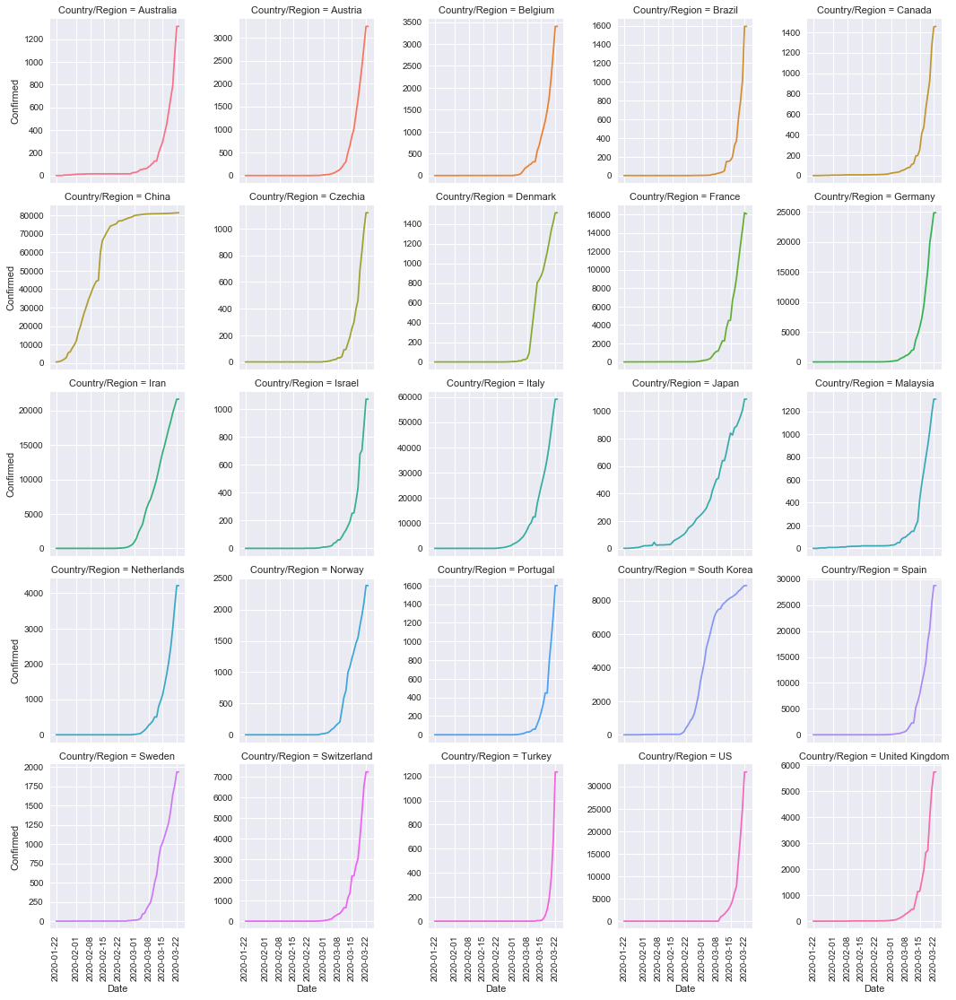

In [43]:
temp = full_table.groupby(['Date', 'Country/Region'])['Confirmed'].sum()
temp = temp.reset_index().sort_values(by=['Date', 'Country/Region'])
temp = temp[temp['Country/Region'].isin(gt_1000)]

plt.style.use('seaborn')
g = sns.FacetGrid(temp, col="Country/Region", hue="Country/Region", sharey=False, col_wrap=5)
g = g.map(plt.plot, "Date", "Confirmed")
g.set_xticklabels(rotation=90)
plt.show()

New cases (countries with > 1000 cases)

In [48]:
temp = full_table.groupby(['Country/Region', 'Date', ])['Confirmed', 'Deaths', 'Recovered']
temp = temp.sum().diff().reset_index()
temp = temp[temp['Country/Region'].isin(gt_1000)]

mask = temp['Country/Region'] != temp['Country/Region'].shift(1)

temp.loc[mask, 'Confirmed'] = np.nan
temp.loc[mask, 'Deaths'] = np.nan
temp.loc[mask, 'Recovered'] = np.nan

# plt.style.use('seaborn')
# g = sns.FacetGrid(temp, col="Country/Region", hue="Country/Region",  sharey=False, col_wrap=5)
# g = g.map(sns.lineplot, "Date", "Confirmed")
# g.set_xticklabels(rotation=90)
# plt.show()

In [49]:
temp = temp.sort_values('Confirmed', ascending=True).dropna()
temp = temp[temp['Confirmed']>0]
temp.head()

,Country/Region,Date,Confirmed,Deaths,Recovered
1773,Canada,2020-02-28,1.0,0.0,0.0
9496,South Korea,2020-02-01,1.0,0.0,0.0
1762,Canada,2020-02-17,1.0,0.0,0.0
10589,Turkey,2020-03-11,1.0,0.0,0.0
9488,South Korea,2020-01-24,1.0,0.0,0.0


In [50]:
temp.isna().sum()

Country/Region    0
Date              0
Confirmed         0
Deaths            0
Recovered         0
dtype: int64

# Calander map

Number of new cases every day

AttributeError: 'DataFrame' object has no attribute 'ix'

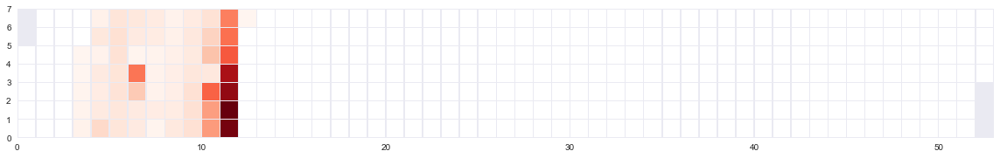

In [51]:
temp = full_table.groupby('Date')['Confirmed'].sum()
temp = temp.diff()

plt.figure(figsize=(20, 5))
ax = calmap.yearplot(temp, fillcolor='white', cmap='Reds', linewidth=0.5)

# Number of new countries every day

AttributeError: 'DataFrame' object has no attribute 'ix'

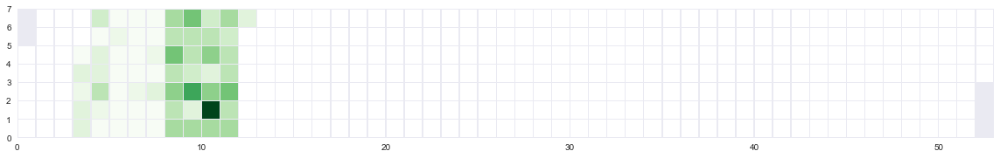

In [54]:
spread = full_table[full_table['Confirmed']!=0].groupby('Date')
spread = spread['Country/Region'].unique().apply(len).diff()

plt.figure(figsize=(20, 5))
ax = calmap.yearplot(spread, fillcolor='white', cmap='Greens', linewidth=0.5)

# Comparison with similar epidemics

In [55]:
epidemics = pd.DataFrame({
    'epidemic' : ['COVID-19', 'SARS', 'EBOLA', 'MERS', 'H1N1'],
    'start_year' : [2019, 2003, 2014, 2012, 2009],
    'end_year' : [2020, 2004, 2016, 2017, 2010],
    'confirmed' : [full_latest['Confirmed'].sum(), 8096, 28646, 2494, 6724149],
    'deaths' : [full_latest['Deaths'].sum(), 774, 11323, 858, 19654]
})

epidemics['mortality'] = round((epidemics['deaths']/epidemics['confirmed'])*100, 2)

epidemics.head()


,epidemic,start_year,end_year,confirmed,deaths,mortality
0,COVID-19,2019,2020,335200.0,14634.0,4.37
1,SARS,2003,2004,8096.0,774.0,9.56
2,EBOLA,2014,2016,28646.0,11323.0,39.53
3,MERS,2012,2017,2494.0,858.0,34.40
4,H1N1,2009,2010,6724149.0,19654.0,0.29


In [56]:
temp = epidemics.melt(id_vars='epidemic', value_vars=['confirmed', 'deaths', 'mortality'],
                      var_name='Case', value_name='Value')

fig = px.bar(temp, x="epidemic", y="Value", color='epidemic', text='Value', facet_col="Case",
             color_discrete_sequence = px.colors.qualitative.Bold)
fig.update_traces(textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_yaxes(showticklabels=False)
fig.layout.yaxis2.update(matches=None)
fig.layout.yaxis3.update(matches=None)
fig.show()

# Analysis on similar epidemics

https://www.kaggle.com/imdevskp/mers-outbreak-analysis 
    
https://www.kaggle.com/imdevskp/sars-2003-outbreak-analysis 
    
https://www.kaggle.com/imdevskp/western-africa-ebola-outbreak-analysis